http://archive.ics.uci.edu/ml/datasets/mhealth+dataset

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
import numpy as np
import pandas as pd
import seaborn as sns
import tensorflow as tf
import matplotlib.pyplot as plt
 
%matplotlib inline
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [7]:
df = pd.read_csv('/content/drive/MyDrive/Datasets/mhealth_human_activity_data/mhealth_resampled_data.csv')
df

,alx,aly,alz,glx,gly,glz,arx,ary,arz,grx,gry,grz,Activity,subject
0,-0.68636,-5.2902,4.64530,0.13544,-0.83114,-0.13163,-8.4230,-6.6402,2.98050,-0.93922,0.090349,0.219830,0,subject1
1,1.00030,-7.7902,-6.74410,-0.26531,-0.14447,-1.09820,2.2046,-7.5497,4.02880,-0.21961,-1.080100,0.303880,0,subject8
2,1.53220,-9.5966,-0.25618,-0.27273,-0.75985,0.63654,-2.5898,-8.5217,3.83430,-0.88431,-0.848050,0.331900,0,subject2
3,1.78090,-8.5942,-3.97440,-0.41002,-0.55535,-0.78389,-1.0049,-6.8588,2.11540,-0.35686,-0.854210,-0.415950,0,subject4
4,-0.34940,-9.5201,1.45800,-0.68275,-0.77861,-0.24558,-1.4178,-9.5157,1.43050,-0.12353,-0.967150,-0.497840,0,subject3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
373190,-2.48730,-19.2330,3.46140,0.61967,-0.33771,-0.82711,-8.2348,-4.9652,2.48090,-0.43725,-1.018500,0.079741,12,subject10
373191,-21.59100,-19.4370,-6.04190,0.61967,-0.33771,-0.82711,-21.3180,-10.2130,3.65600,-0.43725,-1.018500,0.079741,12,subject10
373192,7.54330,-19.2450,-2.66800,0.61967,-0.33771,-0.82711,-21.2970,-18.7050,4.46060,-0.43725,-1.018500,0.079741,12,subject10
373193,3.01420,-19.3340,-7.70740,0.71058,-0.27017,-0.75442,-21.1380,-18.6980,1.15880,-0.42549,-1.037000,0.084052,12,subject10


In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 373195 entries, 0 to 373194
Data columns (total 14 columns):
 #   Column    Non-Null Count   Dtype  
---  ------    --------------   -----  
 0   alx       373195 non-null  float64
 1   aly       373195 non-null  float64
 2   alz       373195 non-null  float64
 3   glx       373195 non-null  float64
 4   gly       373195 non-null  float64
 5   glz       373195 non-null  float64
 6   arx       373195 non-null  float64
 7   ary       373195 non-null  float64
 8   arz       373195 non-null  float64
 9   grx       373195 non-null  float64
 10  gry       373195 non-null  float64
 11  grz       373195 non-null  float64
 12  Activity  373195 non-null  int64  
 13  subject   373195 non-null  object 
dtypes: float64(12), int64(1), object(1)
memory usage: 39.9+ MB


In [17]:
df.isnull().sum()

alx         0
aly         0
alz         0
glx         0
gly         0
glz         0
arx         0
ary         0
arz         0
grx         0
gry         0
grz         0
Activity    0
subject     0
dtype: int64

In [18]:
subject1.Activity.value_counts()

0     4310
8     3379
11    3072
10    3072
9     3072
7     3072
6     3072
5     3072
4     3072
3     3072
2     3072
1     3072
12    1075
Name: Activity, dtype: int64

In [11]:
label_map = {
    0: 'Nothing',
    1: 'Standing still',  
    2: 'Sitting and relaxing', 
    3: 'Lying down',  
    4: 'Walking',  
    5: 'Climbing stairs',  
    6: 'Waist bends forward',
    7: 'Frontal elevation of arms', 
    8: 'Knees bending (crouching)', 
    9: 'Cycling', 
    10: 'Jogging', 
    11: 'Running', 
    12: 'Jump front & back' 
}

In [12]:
def plot_comparison(data, metric = 'acceleration'):
 
  metric = metric[0].lower()
  data = data
 
  for i in range(0,13):
    plt.figure(figsize=(16,4))
 
    plt.subplot(1,2,1)
    plt.plot(data[ data['Activity']==i ].reset_index(drop=True)[metric+'lx'], alpha=.7, label=metric+'lx')
    plt.plot(data[ data['Activity']==i ].reset_index(drop=True)[metric+'ly'],color='red', alpha=.7, label=metric+'ly')
    plt.plot(data[ data['Activity']==i ].reset_index(drop=True)[metric+'lz'],color='green', alpha=.7, label=metric+'lz')
    plt.title(f'{label_map[i]} - left-ankle')
    plt.legend()  
 
    plt.subplot(1,2,2)
    plt.plot(data[ data['Activity']==i ].reset_index(drop=True)[metric+'rx'], alpha=.7, label=metric+'rx')
    plt.plot(data[ data['Activity']==i ].reset_index(drop=True)[metric+'ry'],color='red', alpha=.7, label=metric+'ry')
    plt.plot(data[ data['Activity']==i ].reset_index(drop=True)[metric+'rz'],color='green', alpha=.7, label=metric+'rz')
    plt.title(f'{label_map[i]} - right-lower-arm')
    plt.legend() 
 
    plt.show()
    print()
 
def plot_category(data,cat):
  array = (data[cat].value_counts().sort_values(ascending=False)/len(data))*100
  plt.barh(array.index, width = array.values)
  for index, value in enumerate(array.values):
      plt.text(value + .5 , index, s= '{:.1f}%'.format(value))
  plt.show()

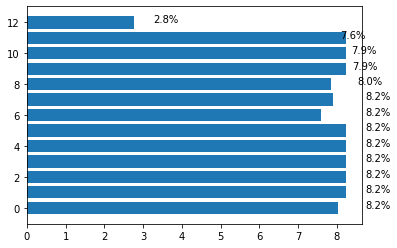

In [19]:
plot_category(df,'Activity')

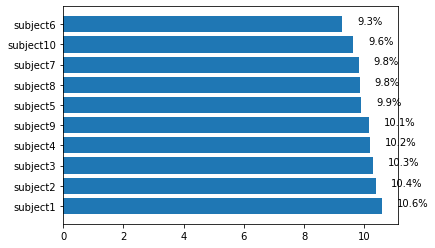

In [20]:
plot_category(df,'subject')

#EDA of 1 subject data

In [10]:
subject1 = df[df['subject']=='subject1']
subject1.Activity.value_counts()

0     4310
8     3379
11    3072
10    3072
9     3072
7     3072
6     3072
5     3072
4     3072
3     3072
2     3072
1     3072
12    1075
Name: Activity, dtype: int64

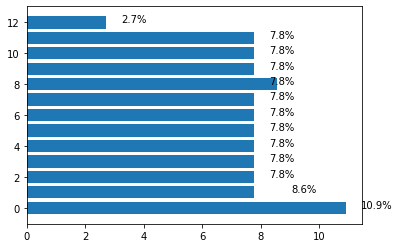

In [13]:
plot_category(subject1,'Activity')

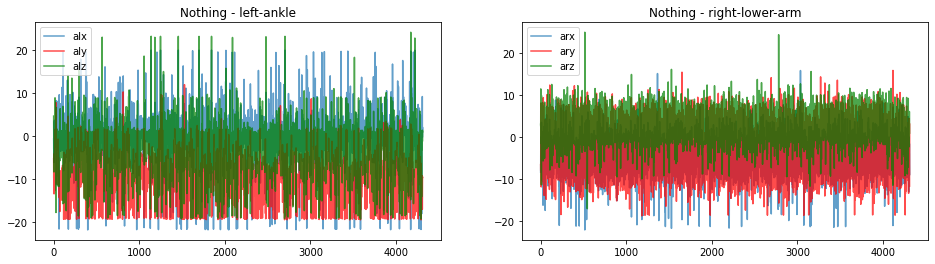

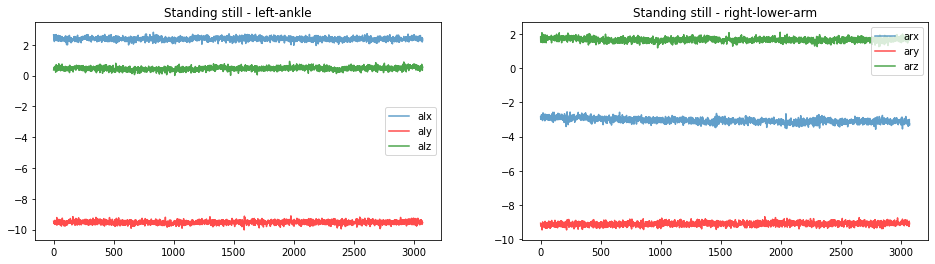

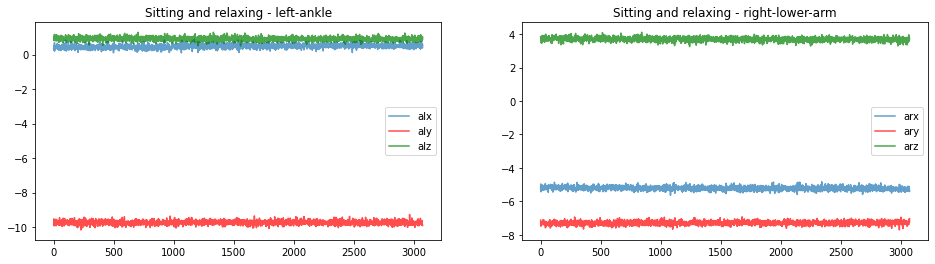

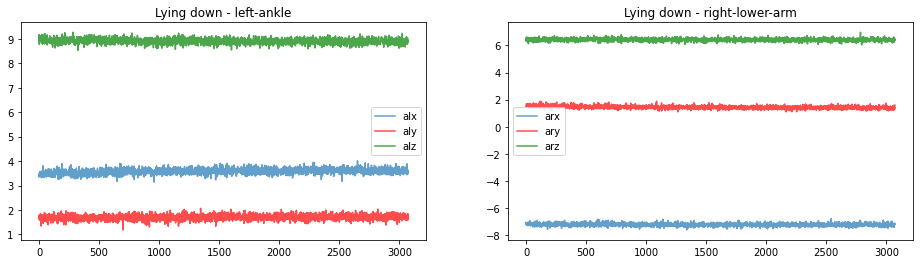

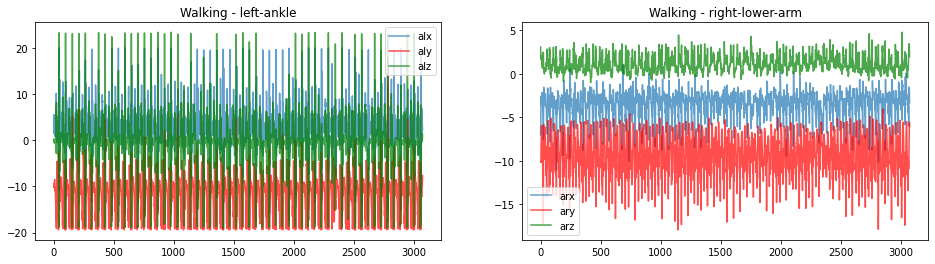

...

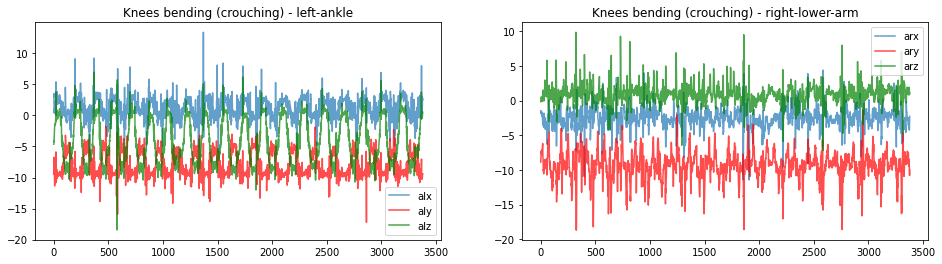

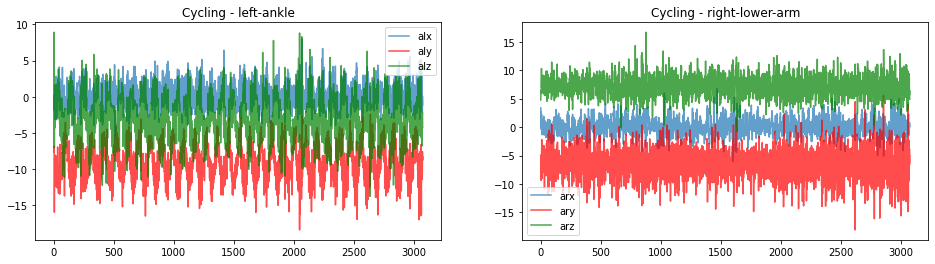

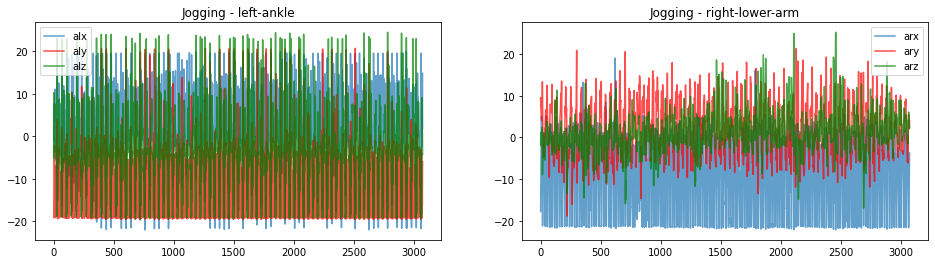

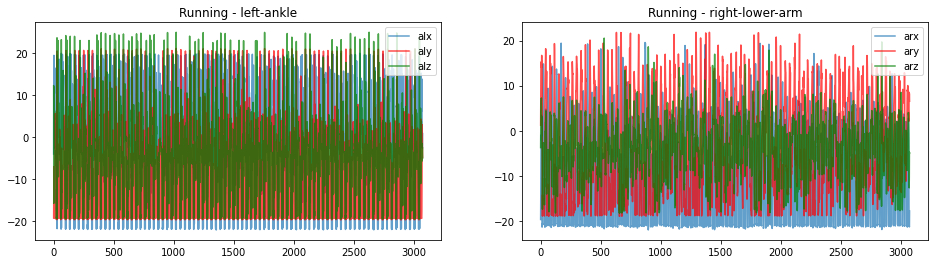

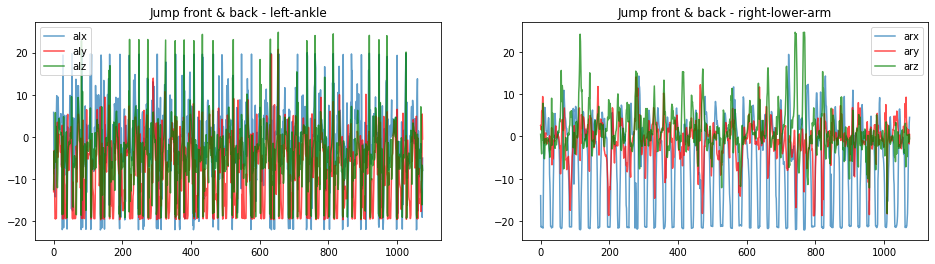

In [14]:
plot_comparison(subject1,'acceleration')

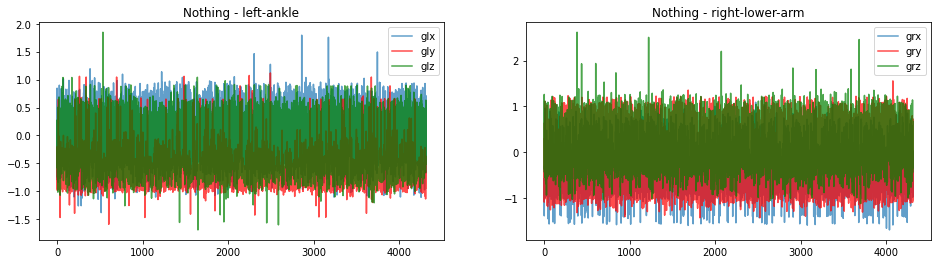

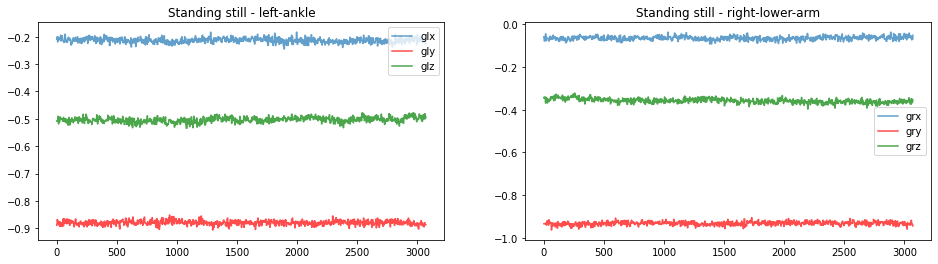

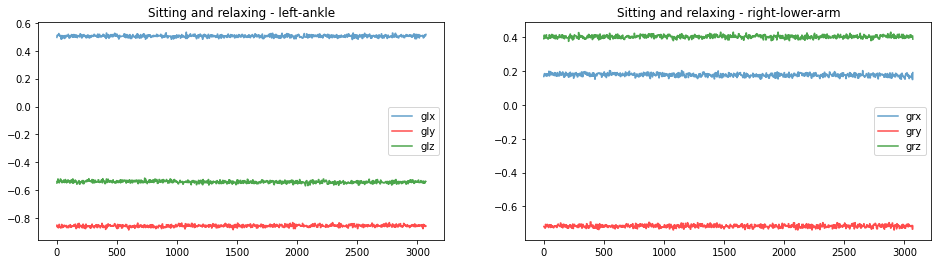

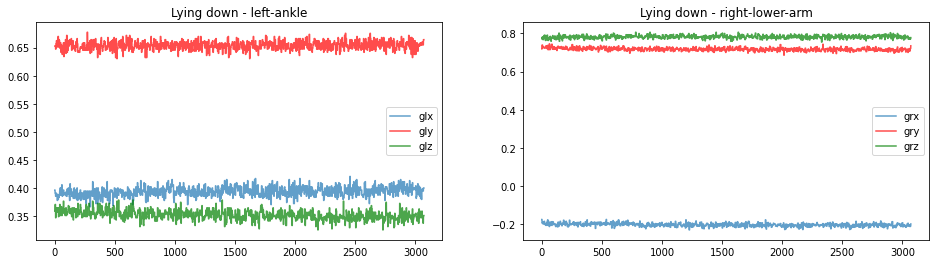

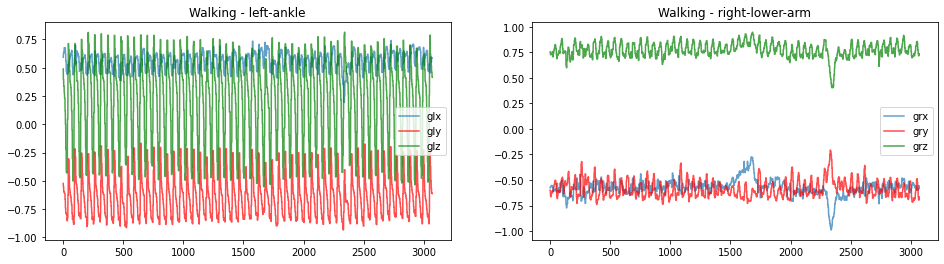

...

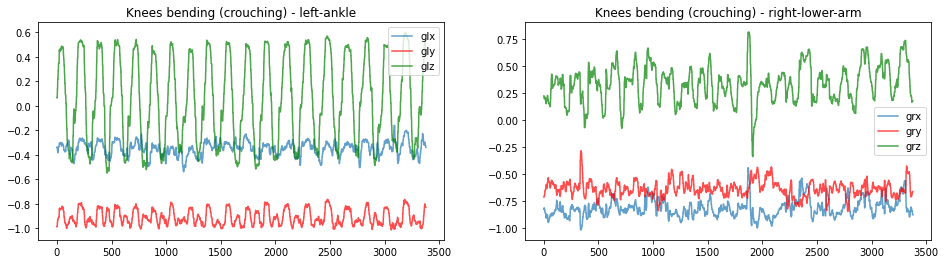

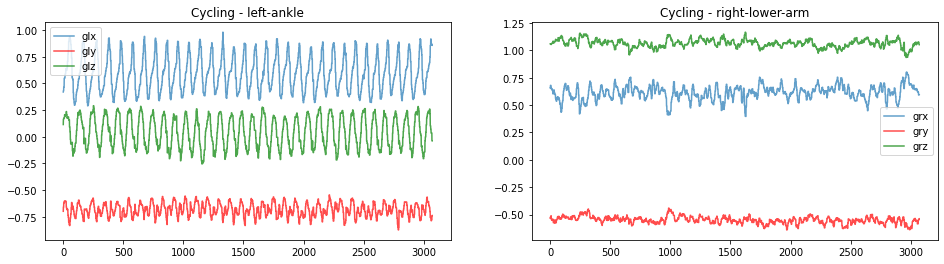

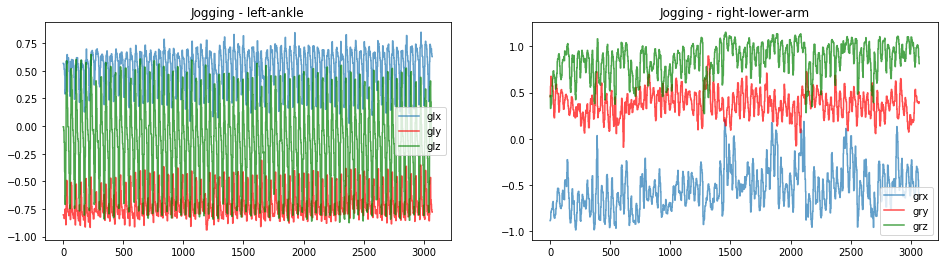

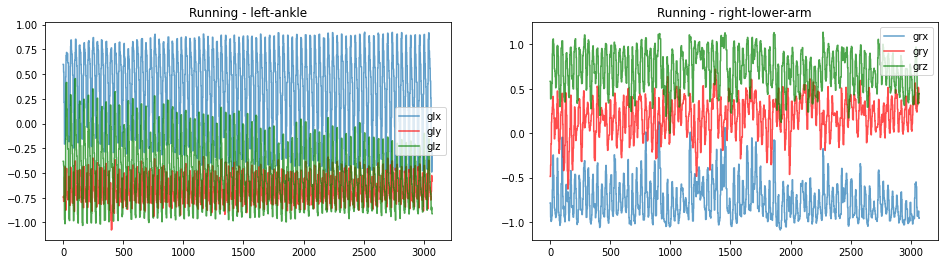

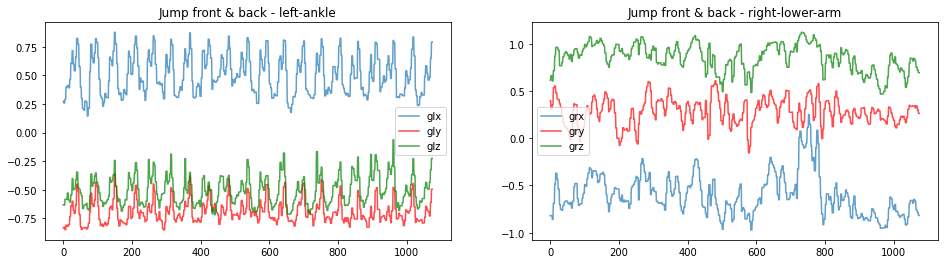

In [15]:
plot_comparison(subject1,'gyroscope')

# EDA of Full Dataset

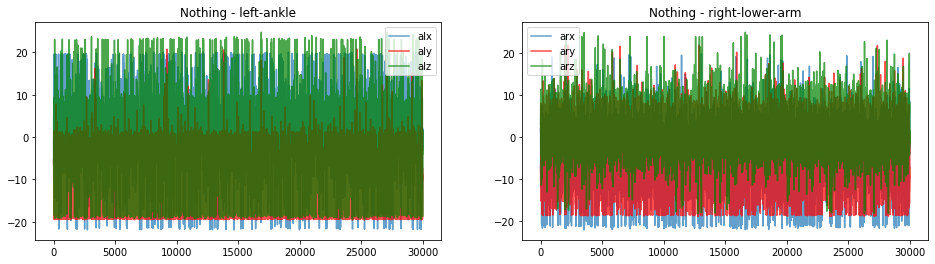

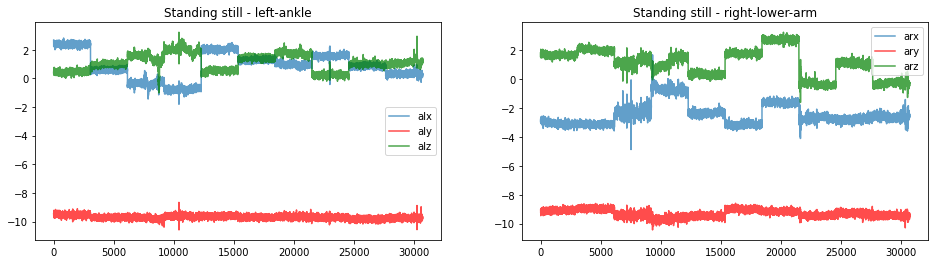

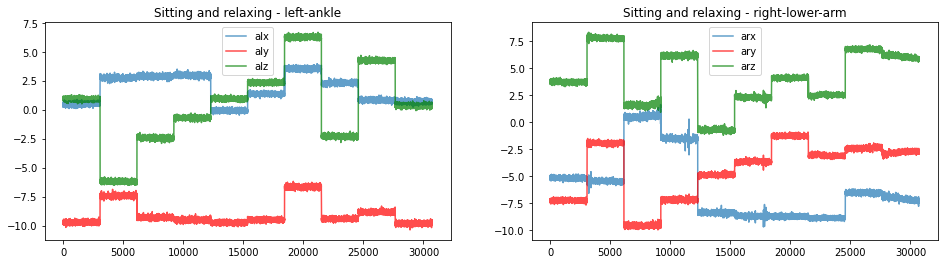

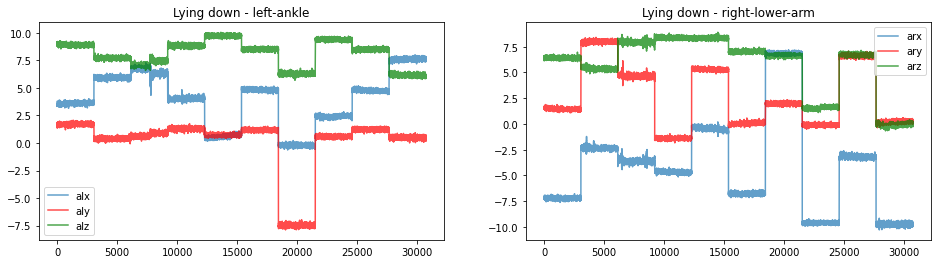

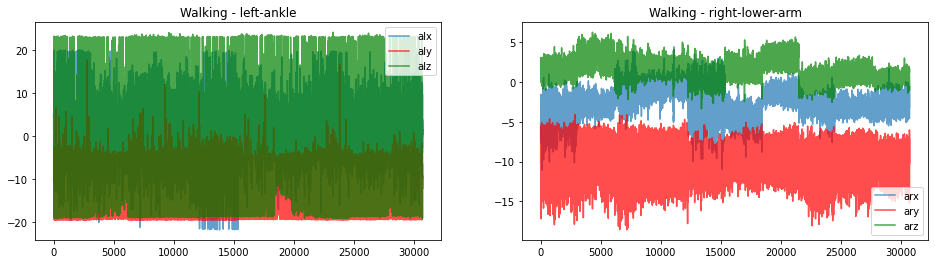

...

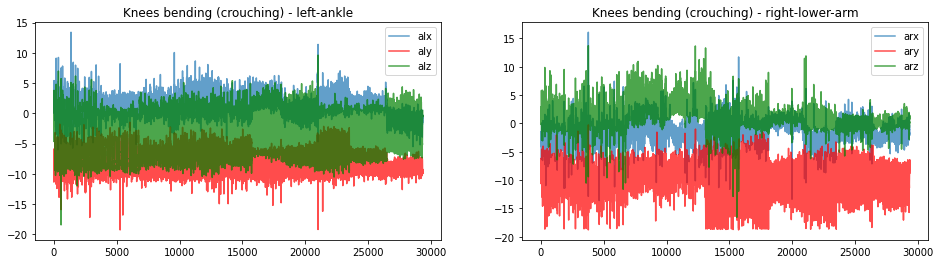

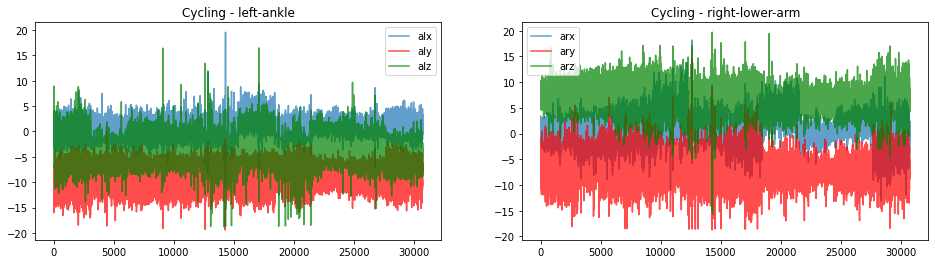

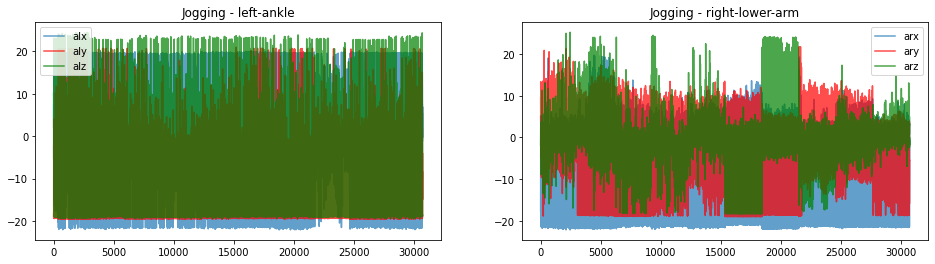

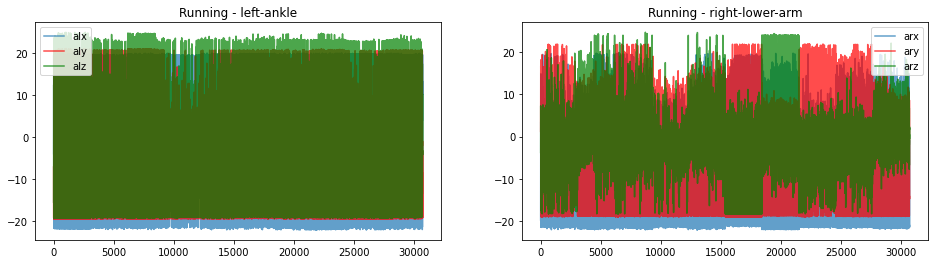

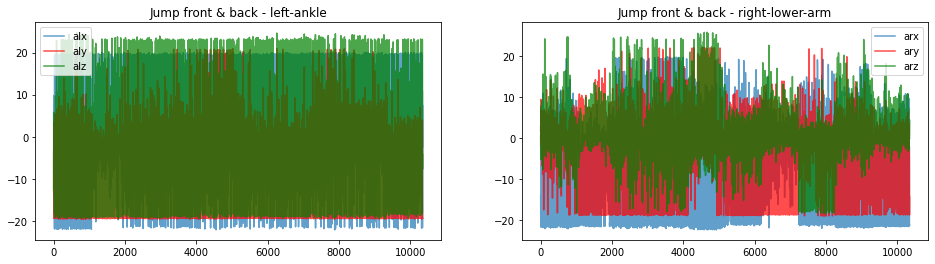

In [23]:
plot_comparison(df)

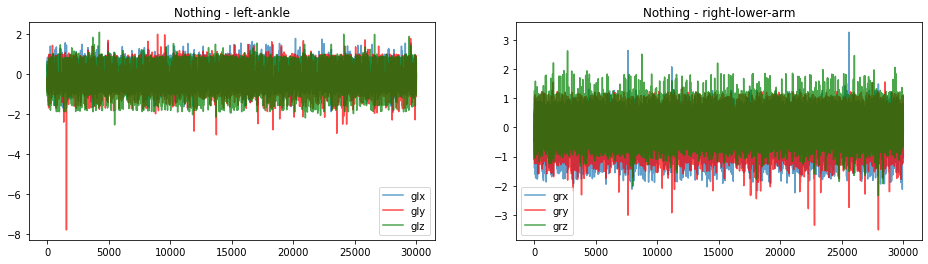

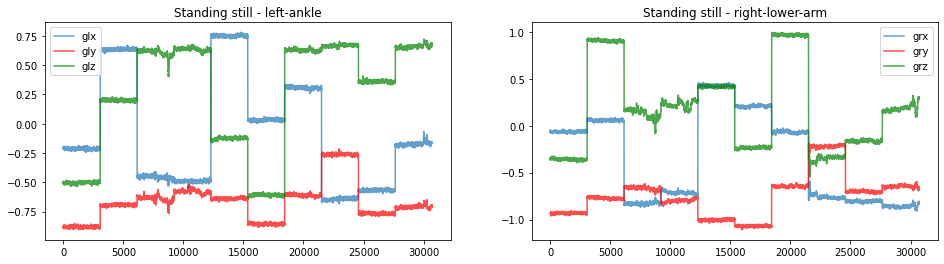

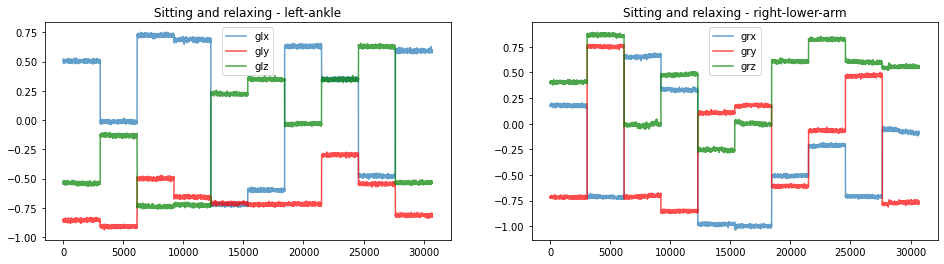

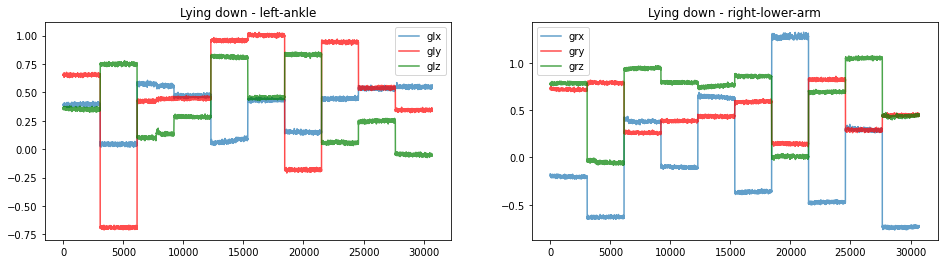

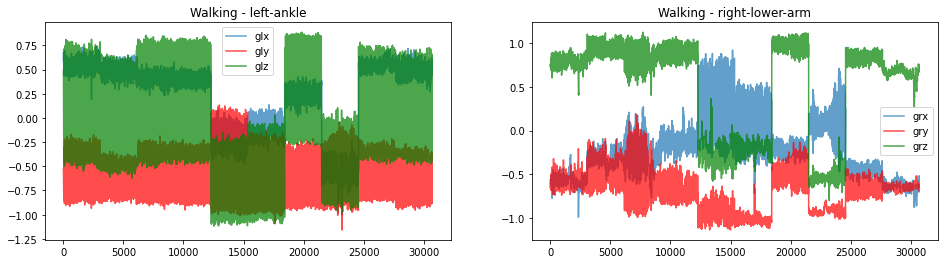

...

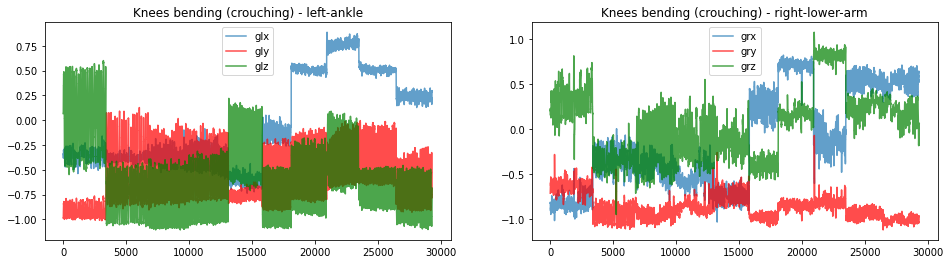

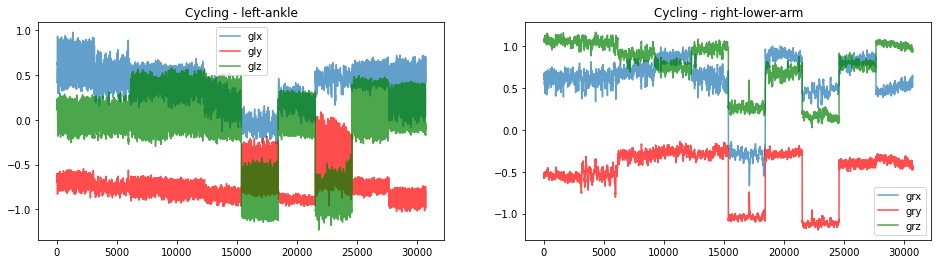

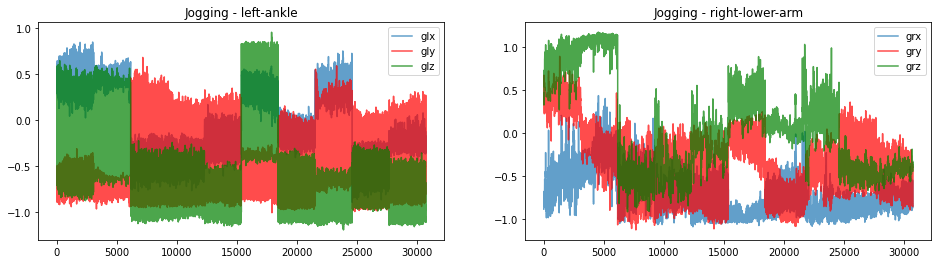

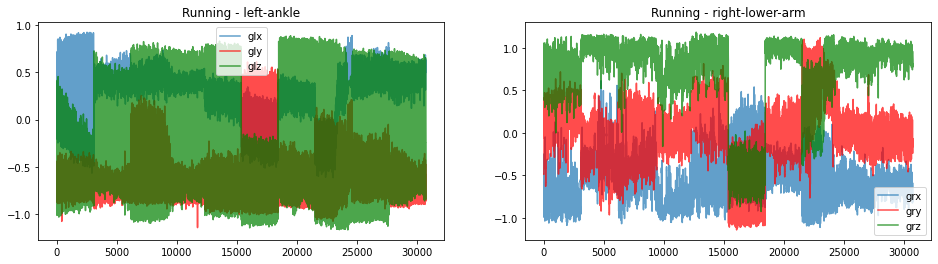

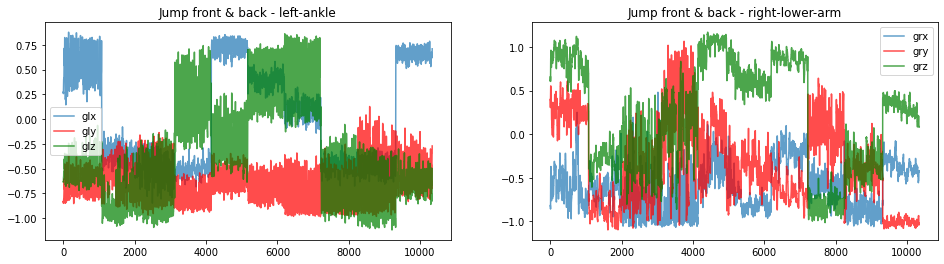

In [24]:
plot_comparison(df,'gyroscope')

#Modeling Data Preparation

In [25]:
train = df[(df['subject'] != 'subject10') & (df['subject'] != 'subject9')]
test = df.drop(train.index, axis=0)
train.shape,test.shape

((299454, 14), (73741, 14))

In [26]:
X_train = train.drop(['Activity','subject'],axis=1)
y_train = train['Activity']
X_test = test.drop(['Activity','subject'],axis=1)
y_test = test['Activity']
X_train.shape,y_train.shape,X_test.shape,y_test.shape

((299454, 12), (299454,), (73741, 12), (73741,))

In [27]:
from scipy import stats
def create_dataset(X, y, time_steps, step=1):
    Xs, ys = [], []
    for i in range(0, len(X) - time_steps, step):
        x = X.iloc[i:(i + time_steps)].values
        labels = y.iloc[i: i + time_steps]
        Xs.append(x)
        ys.append(stats.mode(labels)[0][0])
    return np.array(Xs), np.array(ys).reshape(-1, 1)

In [28]:
X_train,y_train = create_dataset(X_train, y_train, 50, step=25)
X_train.shape, y_train.shape

((11977, 50, 12), (11977, 1))

In [29]:
X_test,y_test = create_dataset(X_test, y_test, 50, step=25)
X_test.shape, y_test.shape

((2948, 50, 12), (2948, 1))

#Model building

In [30]:
import tensorflow as tf
from keras import layers
import keras

In [31]:
model = keras.Sequential()
model.add(layers.Input(shape=[50,12]))
model.add(layers.LSTM(128))
model.add(keras.layers.Dense(units=128, activation='relu'))
model.add(keras.layers.Dense(13, activation='sigmoid'))
 
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm (LSTM)                  (None, 128)               72192     
_________________________________________________________________
dense (Dense)                (None, 128)               16512     
_________________________________________________________________
dense_1 (Dense)              (None, 13)                1677      
Total params: 90,381
Trainable params: 90,381
Non-trainable params: 0
_________________________________________________________________


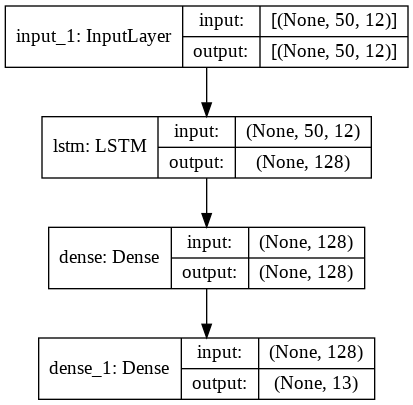

In [32]:
tf.keras.utils.plot_model(model, show_shapes=True)

In [33]:
import datetime
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)
 
model.compile(loss='sparse_categorical_crossentropy',optimizer='adam',metrics=['accuracy'])
 
model_history = model.fit(X_train,y_train, epochs=5, validation_data=(X_test,y_test),callbacks=[tensorboard_callback])

Epoch 1/5
375/375 [==============================] - 22s 54ms/step - loss: 1.0015 - accuracy: 0.6811 - val_loss: 0.2524 - val_accuracy: 0.9257
Epoch 2/5
375/375 [==============================] - 19s 51ms/step - loss: 0.1282 - accuracy: 0.9633 - val_loss: 0.4240 - val_accuracy: 0.9020
Epoch 3/5
375/375 [==============================] - 19s 52ms/step - loss: 0.0673 - accuracy: 0.9800 - val_loss: 0.2383 - val_accuracy: 0.8996
Epoch 4/5
375/375 [==============================] - 20s 52ms/step - loss: 0.0557 - accuracy: 0.9840 - val_loss: 0.4534 - val_accuracy: 0.8769
Epoch 5/5
375/375 [==============================] - 22s 58ms/step - loss: 0.0449 - accuracy: 0.9871 - val_loss: 0.5909 - val_accuracy: 0.8168


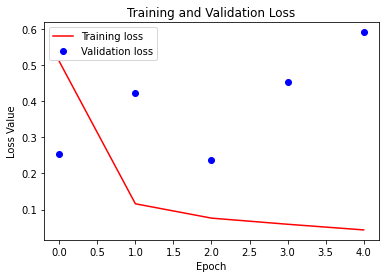

In [34]:
loss = model_history.history['loss']
val_loss = model_history.history['val_loss']
 
 
plt.figure()
plt.plot(loss, 'r', label='Training loss')
plt.plot(val_loss, 'bo', label='Validation loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss Value')
plt.legend()
plt.show()

In [35]:
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>